<a href="https://colab.research.google.com/github/NirjharDebnath/Optimisation-algorithms/blob/main/TSP_by_PSO.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time as time

In [ ]:
dataset_size = "large" # large, medium, small, tiny

In [ ]:
large_data_path = f"/home/nirjhar/Python Codes/Machine Learning/data/archive/{dataset_size}.csv"

In [ ]:
large_data = pd.read_csv(large_data_path)
print(large_data)

            X         Y
0    0.077518  0.017018
1    0.892075  0.737351
2    0.034545  0.418465
3    0.491475  0.643941
4    0.000905  0.633602
..        ...       ...
995  0.847369  0.338414
996  0.971654  0.900917
997  0.164339  0.870318
998  0.492553  0.679674
999  0.658919  0.458835

[1000 rows x 2 columns]


In [ ]:
X, Y = np.array(large_data['X']), np.array(large_data['Y'])

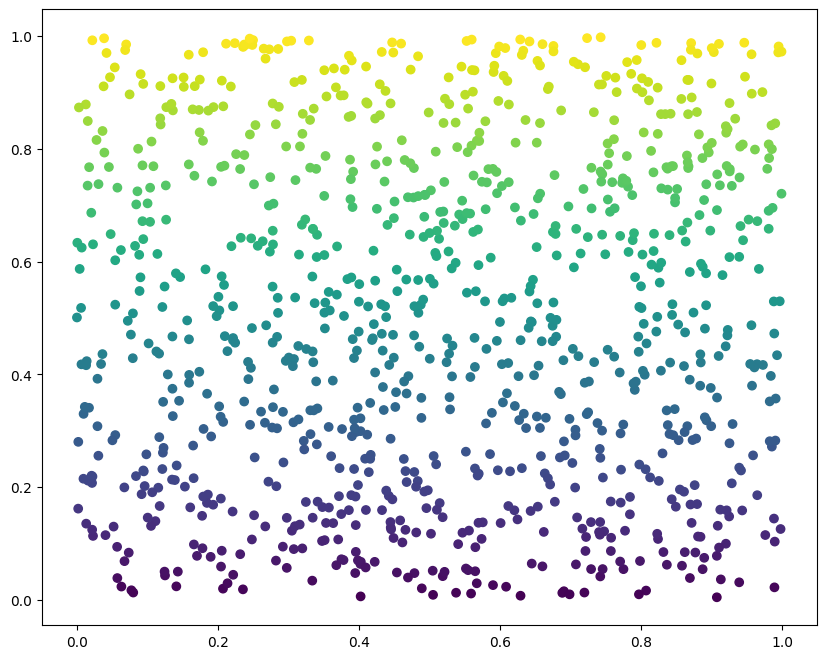

In [ ]:
plt.figure(figsize=(10, 8))
plt.scatter(X, Y, c=Y, cmap=plt.cm.viridis)
plt.show()

In [ ]:
import numpy as np

# Sample coordinates of cities (replace with your own)
cities = [(X[i], Y[i]) for i in range(len(X))]
# Function to calculate the Euclidean distance
def euclidean_distance(coord1, coord2):
    return np.sqrt((coord1[0] - coord2[0])**2 + (coord1[1] - coord2[1])**2)

# Create the distance matrix
def create_distance_matrix(coords):
    n = len(coords)
    distance_matrix = np.zeros((n, n))
    for i in range(n):
        for j in range(n):
            distance_matrix[i][j] = euclidean_distance(coords[i], coords[j])
    return distance_matrix

# Generate the distance matrix
distance_matrix = create_distance_matrix(cities)

# Display the result
print("Distance Matrix:")
print(distance_matrix)
print(distance_matrix.shape)

Distance Matrix:
[[0.         1.08737494 0.4037408  ... 0.85770626 0.78189971 0.73022527]
 [1.08737494 0.         0.91490283 ... 0.73978389 0.40366451 0.36322663]
 [0.4037408  0.91490283 0.         ... 0.4701256  0.52725836 0.62567754]
 ...
 [0.85770626 0.73978389 0.4701256  ... 0.         0.37956478 0.6433721 ]
 [0.78189971 0.40366451 0.52725836 ... 0.37956478 0.         0.27649159]
 [0.73022527 0.36322663 0.62567754 ... 0.6433721  0.27649159 0.        ]]
(1000, 1000)


Best Route : [655, 917, 716, 486, 255, 271, 815, 817, 279, 544, 121, 652, 47, 87, 414, 700, 475, 154, 307, 979, 265, 175, 378, 95, 178, 385, 119, 698, 392, 70, 430, 779, 169, 867, 498, 123, 541, 844, 755, 330, 416, 391, 197, 170, 371, 891, 257, 927, 229, 270, 192, 552, 90, 935, 428, 509, 346, 763, 431, 603, 13, 449, 767, 929, 777, 680, 313, 315, 423, 433, 526, 608, 607, 696, 285, 311, 402, 356, 699, 372, 40, 503, 26, 910, 990, 212, 999, 302, 434, 889, 277, 520, 55, 10, 573, 992, 200, 943, 931, 756, 759, 160, 757, 546, 661, 232, 707, 916, 220, 198, 736, 684, 712, 772, 454, 354, 234, 167, 761, 837, 499, 93, 421, 426, 309, 142, 562, 694, 161, 789, 718, 688, 617, 862, 250, 117, 641, 113, 107, 162, 613, 54, 366, 262, 683, 519, 124, 807, 242, 974, 578, 881, 602, 795, 856, 936, 33, 72, 705, 130, 947, 131, 525, 35, 586, 140, 44, 636, 225, 833, 21, 735, 16, 238, 256, 638, 980, 5, 400, 669, 105, 272, 870, 341, 796, 758, 204, 832, 340, 865, 571, 790, 933, 210, 252, 443, 166, 606, 741, 518, 563, 2

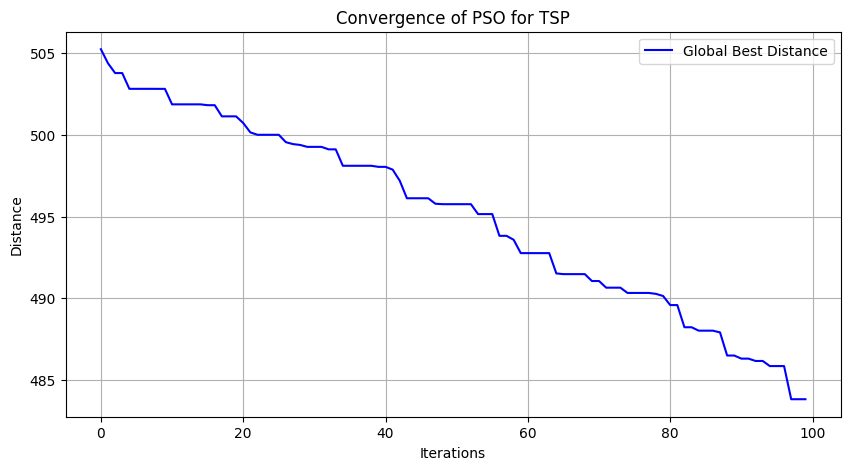

In [ ]:
import random

distance_matrix = np.array(distance_matrix)

# Coordinates for cities (for visualization purposes)
city_coordinates = cities

# Function to calculate total distance of a tour
def calculate_total_distance(tour, distance_matrix):
    total_distance = 0
    for i in range(len(tour) - 1):
        total_distance += distance_matrix[tour[i], tour[i + 1]]
    total_distance += distance_matrix[tour[-1], tour[0]]  # Return to start
    return total_distance

# PSO parameters
num_particles = 10
num_iterations = 100
num_cities = distance_matrix.shape[0]

# Initialize particles to be done by Model in future
particles = [random.sample(range(num_cities), num_cities) for _ in range(num_particles)] # Initialising all the PARTICLES(A Route) in particles=[particle1, particle2, particle3, .... , particleN]
personal_best_positions = particles.copy()
personal_best_scores = [calculate_total_distance(p, distance_matrix) for p in particles] # score is same as distance covered while travelling through the cities
global_best_position = personal_best_positions[np.argmin(personal_best_scores)]
global_best_score = min(personal_best_scores)

best_scores = []

# PSO main loop
start = time.time()

for iteration in range(num_iterations):
    for i in range(num_particles):
        # Velocities defined by swaping random cities in a route for exploration of all routes approximately
        new_position = particles[i][:]
        city1, city2 = random.sample(range(num_cities), 2)
        new_position[city1], new_position[city2] = new_position[city2], new_position[city1]

        new_score = calculate_total_distance(new_position, distance_matrix)

        if new_score < personal_best_scores[i]:
            personal_best_positions[i] = new_position
            personal_best_scores[i] = new_score

        if new_score < global_best_score:
            global_best_position = new_position
            global_best_score = new_score

    particles = personal_best_positions.copy()

    # Accumulate the global best score for plotting
    best_scores.append(global_best_score)

end = time.time()

print(f"Best Route : {global_best_position}")
print(f"Best Score = {global_best_score} units")

print(f"Total Time Taken For Optimisation Using {num_particles} Particles , on {num_cities} Cities , for {num_iterations} Iterations = {(end-start)*1000}ms")
# Plot convergence
plt.figure(figsize=(10, 5))
plt.plot(best_scores, label="Global Best Distance", color="blue")
plt.title("Convergence of PSO for TSP")
plt.xlabel("Iterations")
plt.ylabel("Distance")
plt.legend()
plt.grid()
plt.show()



In [ ]:
# Plot the optimal tour
def plot_tour(tour, coordinates):
    if num_cities == 1000:
        plt.figure(figsize=(100, 100))
    if num_cities == 100:
        plt.figure(figsize=(40, 40))
    if num_cities == 30:
        plt.figure(figsize=(20, 20))
    if num_cities == 10:
        plt.figure(figsize=(10, 10))
    tour_coords = [coordinates[city] for city in tour + [tour[0]]]  # Close the loop
    x, y = zip(*tour_coords)
    plt.plot(x, y, marker='o', color='red', label="Optimal Tour")
    for i, coord in enumerate(coordinates):
        plt.text(coord[0], coord[1], f"City {i}", fontsize=12, ha='center', va='center')
    plt.title("Optimal Tour")
    plt.xlabel("X")
    plt.ylabel("Y")
    plt.legend()
    plt.grid()
    plt.show()

plot_tour(global_best_position, city_coordinates)
